In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [3]:
date="05-06-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
#dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
#root_file=dir+"/analysis_full_e16_geo_fid.root"
root_file=dir+"/sim_e16_clas6_fid_geo_"+date+".root"
file=uproot3.open(root_file)

species="ele"
detector="ec"
cut="pid"

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
side = ["left","coinc","right","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all 

slope_sides = ["right","left"]

edge_fracs = [0.0,0.8,1.6]
gaus_fracs = [0.8,0.5,0.1]

color_order = ['b','g','r']
rv_color_order = ['r','g','b']
cut_name = ['tight','mid','loose']
rv_cut_name = ['loose','mid','tight']

In [4]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

    

In [5]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

#hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]
hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[hist_idx]] for hist_idx in range(round(hist_idx_len))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/2)#4)

In [6]:
def Linear(x_, a_, b_):
    return a_ + b_*x_

In [7]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [8]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_


In [9]:
print(XY_Values(hist[0][0]))

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [10]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 2
y_merge = 2


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]



In [11]:
xdim = len(xvals)
ydim = len(yvals)

xres = xvals[1]-xvals[0]
yres = yvals[1]-yvals[0]

def shift_idx(x_shift_):
    return round(x_shift_/xres)

In [12]:
print(len(zvals_xy[2]))
print(len(YX_Values(hist[0][0])))

1
300


In [13]:
def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

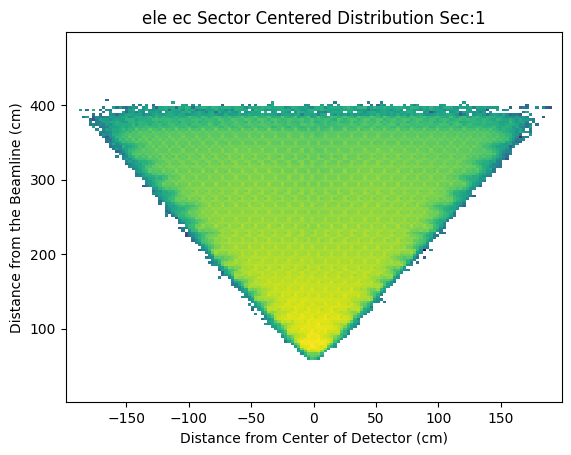

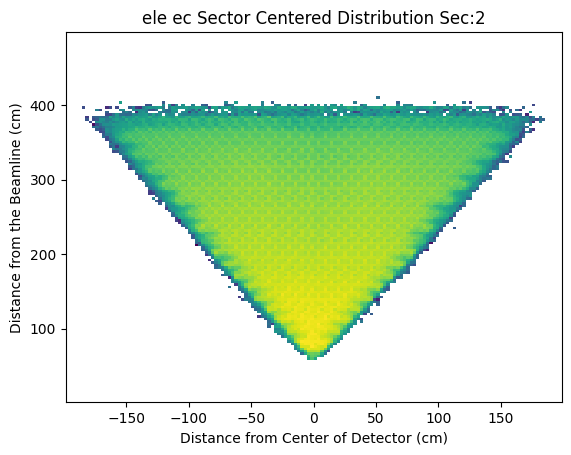

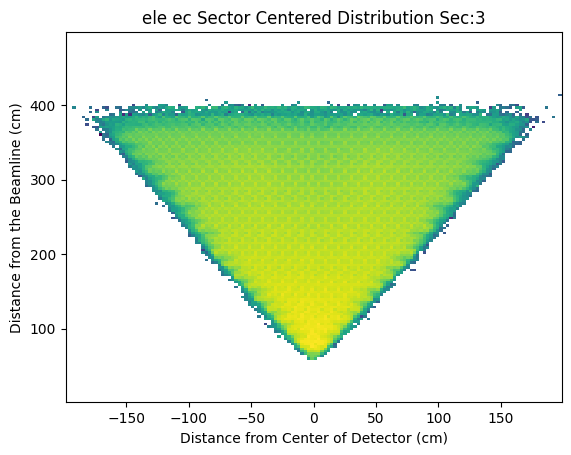

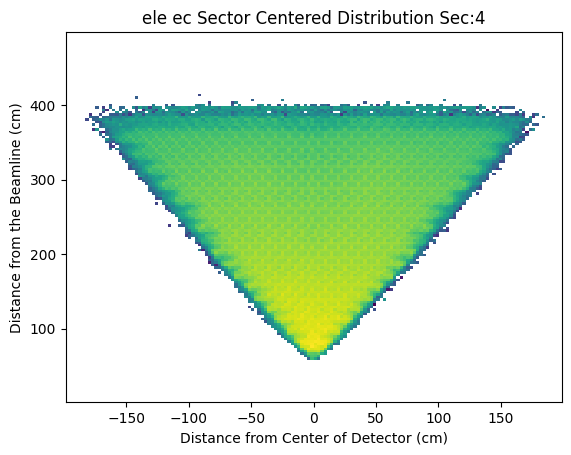

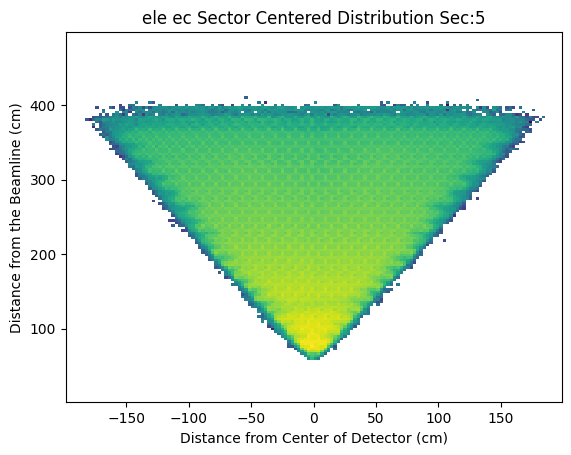

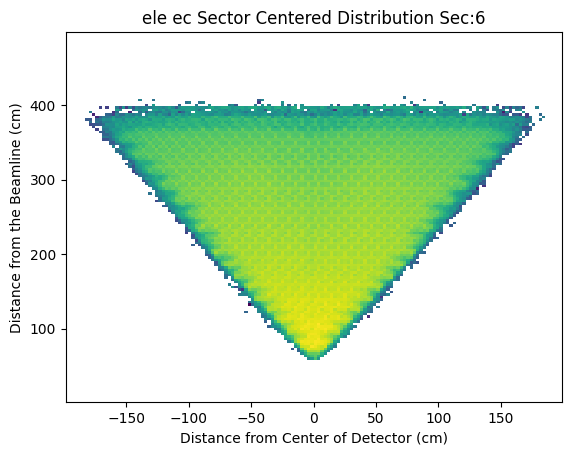

In [14]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{}".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [15]:
yvals[29]
yvals[89]

298.33333333333337

In [16]:
idx1 = 29
idx2=89
fit_len = idx2-idx1
yidx = [idx1+i for i in range(fit_len)]

xrange = [[-50-i*(yvals[idx2]-yvals[idx1])/(fit_len),50+i*(yvals[idx2]-yvals[idx1])/(fit_len)] for i in range(fit_len)]

#x_points = np.zeros()

right_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]
left_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]

ini_pars = []

print(xrange[20])

[-116.66666666666667, 116.66666666666667]


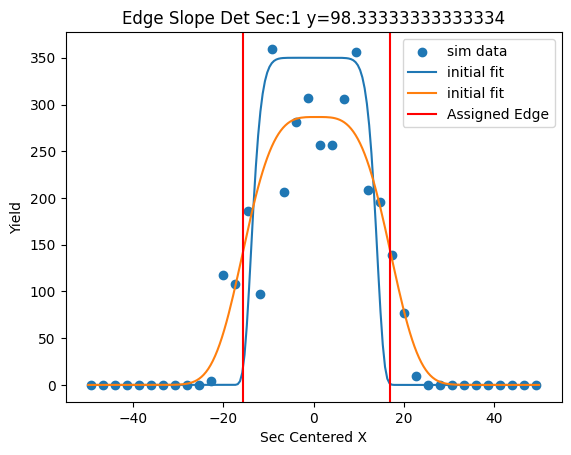

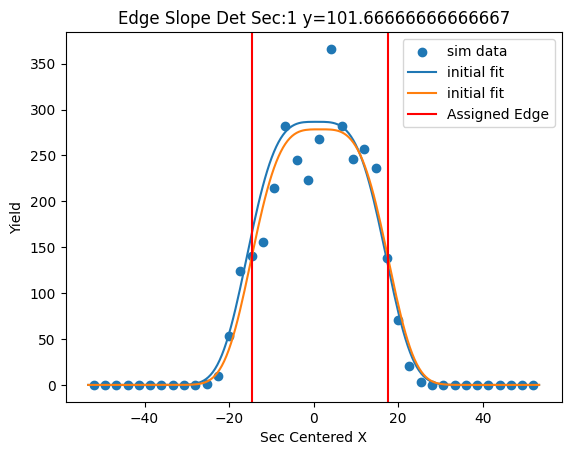

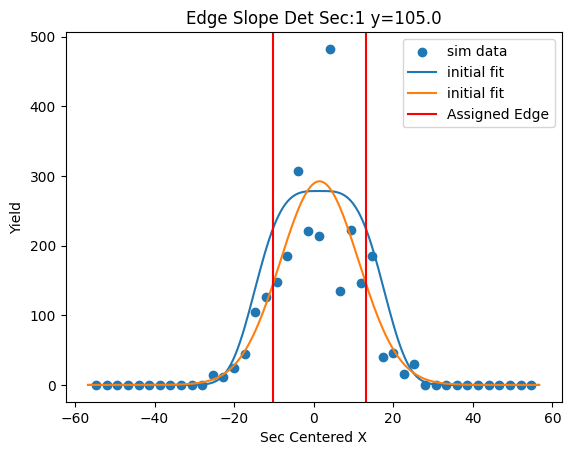

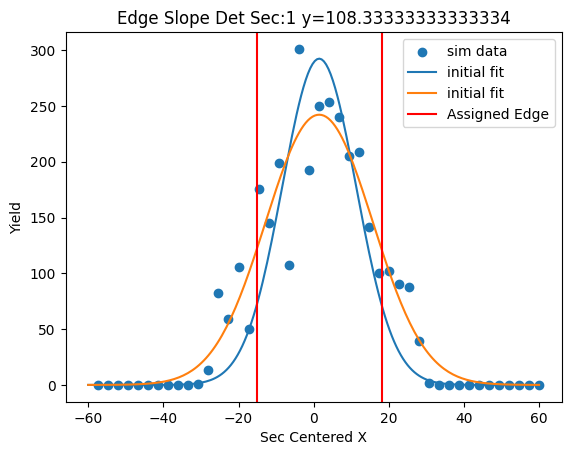

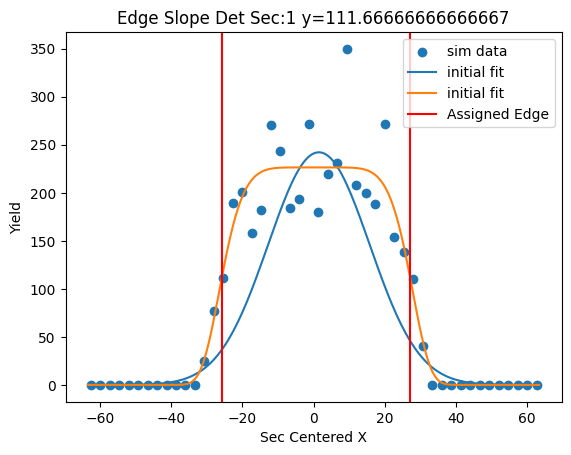

...

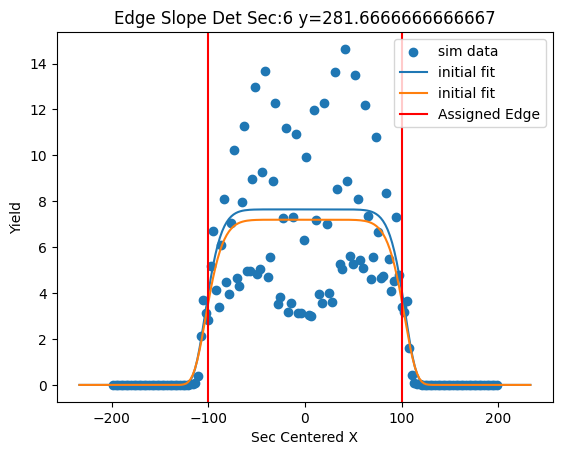

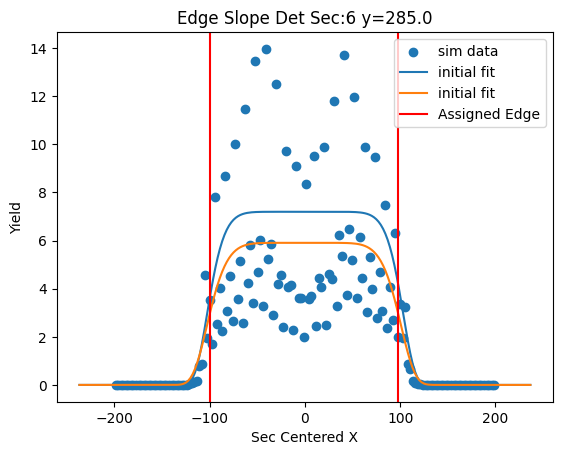

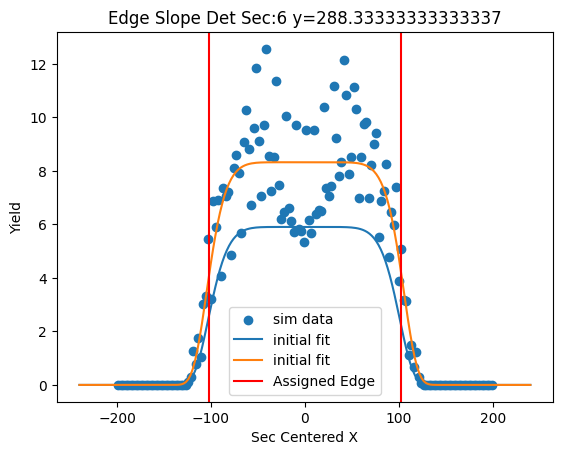

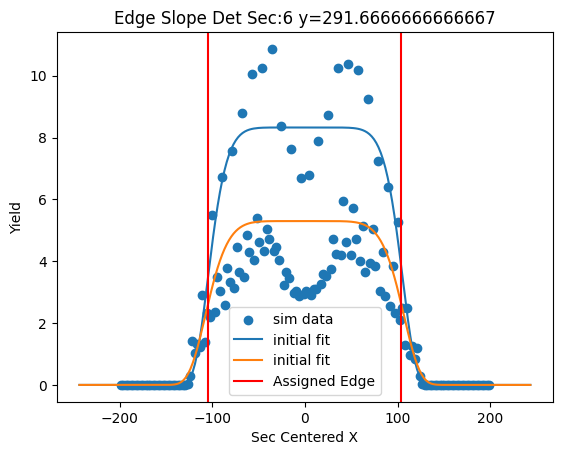

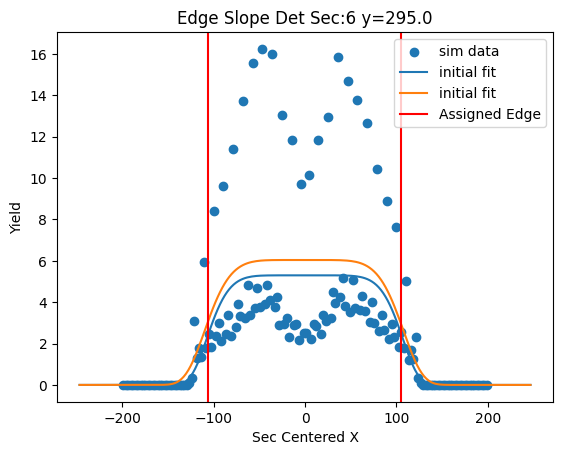

In [17]:

ini_pars = [350,0.1,10,10.0]

test_pars = np.zeros(4)

x_points = np.zeros((6,2,fit_len))
y_points = [yvals[idx1 + i] for i in range(fit_len)]

for sec in range(6):
    for j in range(4):
        test_pars[j] = ini_pars[j]
    for b in range(fit_len):
        mod_xvals = Bounds_on_Y(xvals,xrange[b][0],xrange[b][1])
        mod_zvals = Bounds_on_X_From_Y(zvals_yx[sec][0][yidx[b]],xvals,xrange[b][0],xrange[b][1])
        plt.scatter(mod_xvals,mod_zvals,label="sim data")
        
        cont_x = np.linspace(xrange[b][0],xrange[b][1],200)
        plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="initial fit")
        try:
            pars, pars_cov = op.curve_fit(Super_Gaus,mod_xvals,mod_zvals,p0=test_pars,maxfev=5000)
            plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="initial fit")
            x_points[sec][1][b] = super_gaus_cut_bound(0.5,0,*pars)
            x_points[sec][0][b] = super_gaus_cut_bound(0.5,1,*pars)
            plt.axvline(x=x_points[sec][1][b],color='r',label="Assigned Edge")
            plt.axvline(x=x_points[sec][0][b],color='r')
            for i in range(4):
                test_pars[i] = pars[i]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error") 
        
        plt.title("Edge Slope Det Sec:{} y={}".format(sec+1,yvals[yidx[b]]))
        plt.xlabel("Sec Centered X")
        plt.ylabel("Yield")
        plt.legend()
        plt.show()
    #right_rot[sec] =  (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][1]-x_points[sec][0][1])
    #left_rot[sec] = (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][0]-x_points[sec][0][0])
    #print("Right Slope = ",right_rot[sec])
    #print("Left Slope = ",left_rot[sec])

[64.81302721  2.13892508]
[66.70305761 -2.11661878]


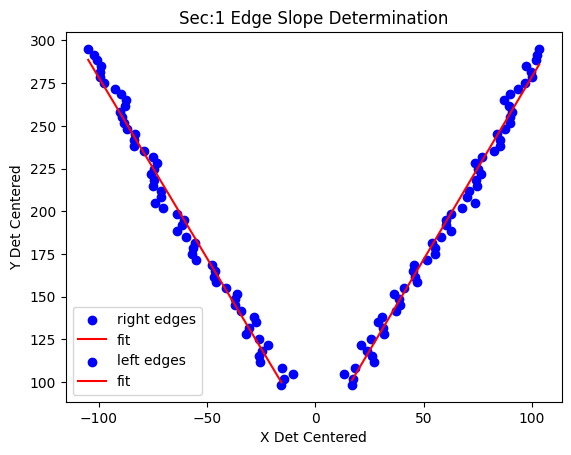

[67.70948047  2.08904837]
[69.18443478 -2.05002283]


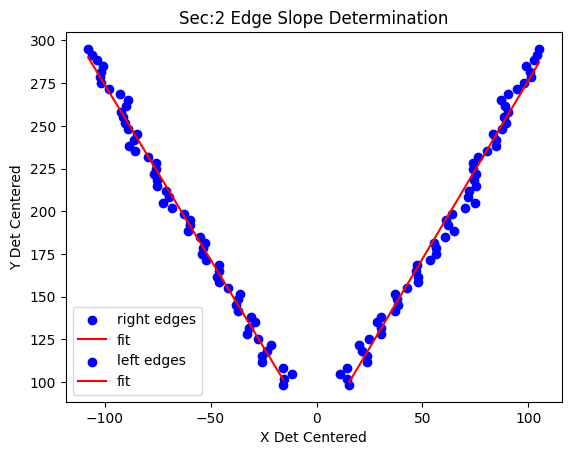

[63.25864933  2.11647426]
[64.84980537 -2.09893869]


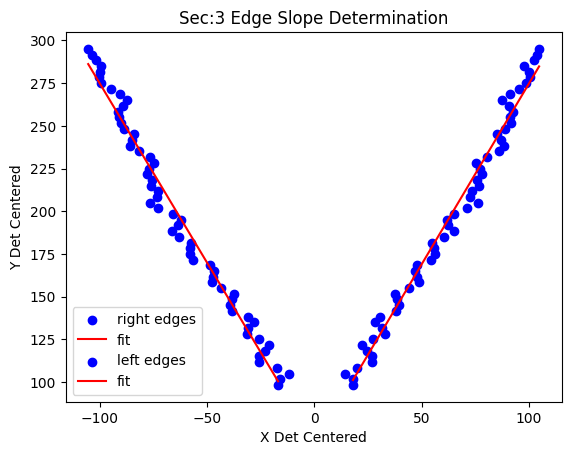

[60.74725386  2.14614986]
[65.00685804 -2.12966297]


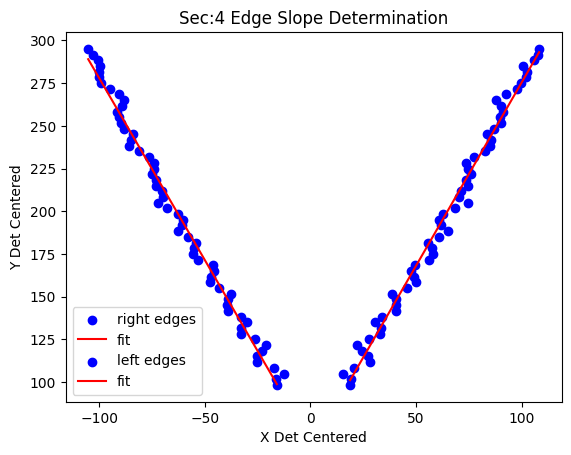

[70.25959098  2.06682648]
[66.69995667 -2.09867059]


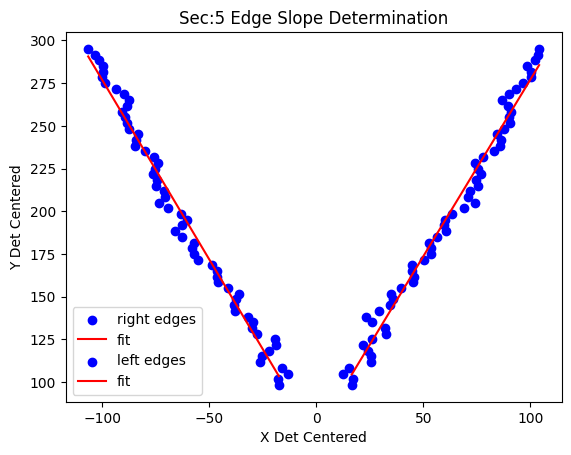

[64.50264654  2.10358016]
[68.27297333 -2.07472805]


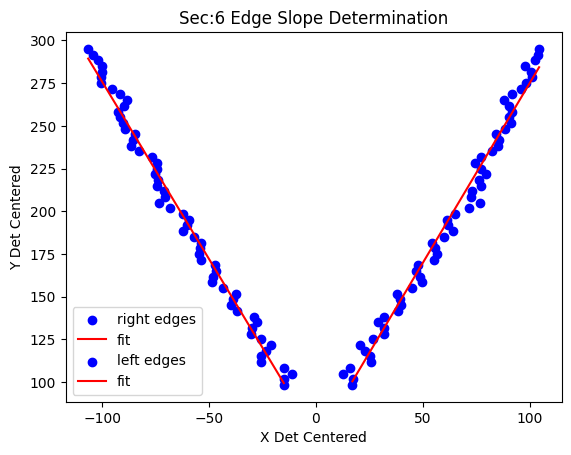

In [18]:
ini_pars = [[70,2.2,],[70,-2.2]]

test_pars = np.zeros((2,2))



for sec in range(6):
    for i in range(2):
        test_pars[0][i] = ini_pars[0][i]
        test_pars[1][i] = ini_pars[1][i]
    for side in range(2):
        plt.scatter(x_points[sec][side],y_points,label="{} edges".format(slope_sides[side]),color='b')
        cont_x = np.linspace(x_points[sec][side][0],x_points[sec][side][fit_len-1],200)
        #plt.plot(cont_x,Poly(cont_x,test_pars[side]),label="{} initial fit".format(slope_sides[side]))
        try:
            pars, pars_cov = op.curve_fit(Linear,x_points[sec][side],y_points,p0=test_pars[side],maxfev=5000)
            print(pars)
            plt.plot(cont_x,Poly(cont_x,pars),label="fit",color='r')
            if side == 0:
                right_rot[sec] = pars[1]
            elif side == 1:
                left_rot[sec] = pars[1]
        except RuntimeError:
            print("Runtime Error")
        except ValueError:
            print("Value Error")
    plt.title("Sec:{} Edge Slope Determination".format(sec+1))
    plt.xlabel("X Det Centered")
    plt.ylabel("Y Det Centered")
    plt.legend()
    plt.show()

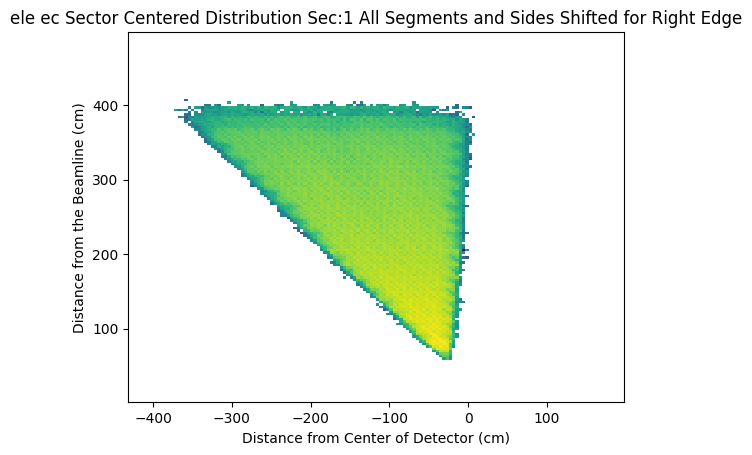

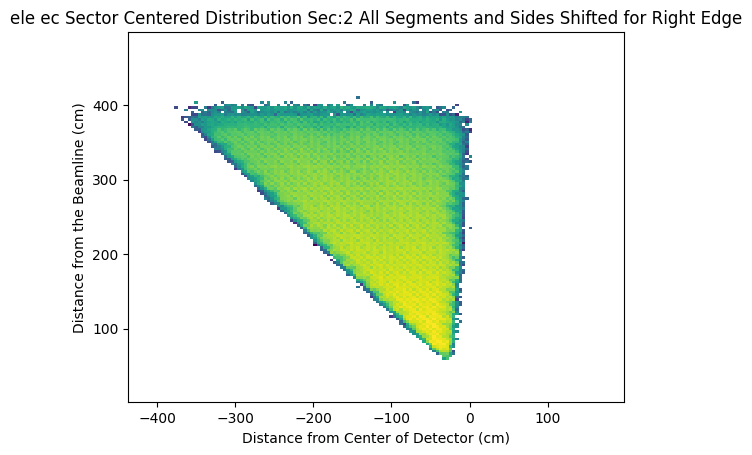

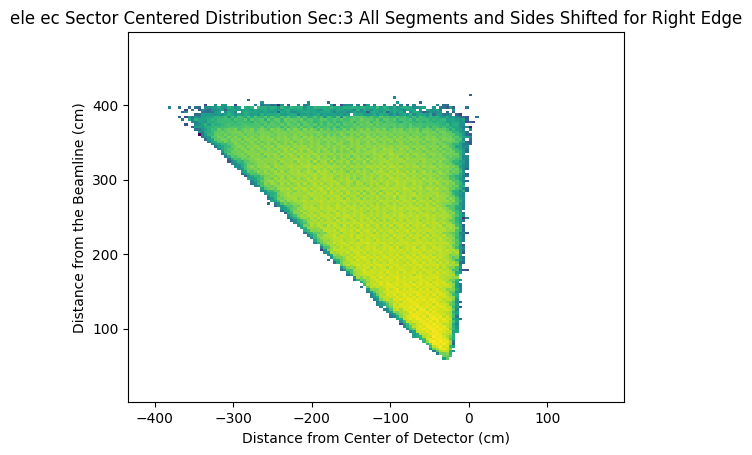

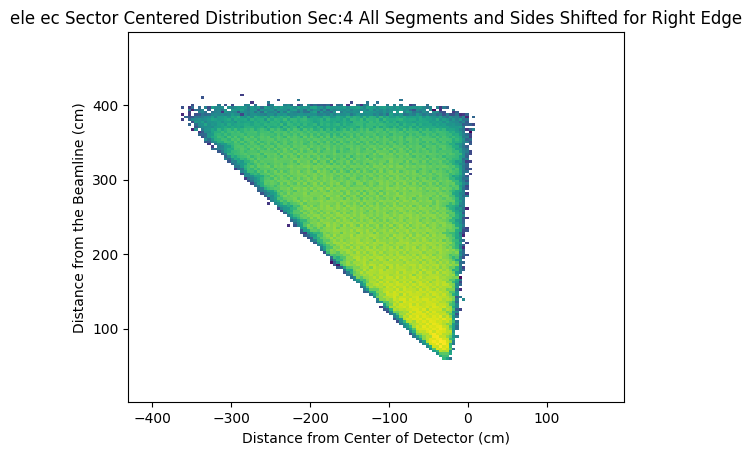

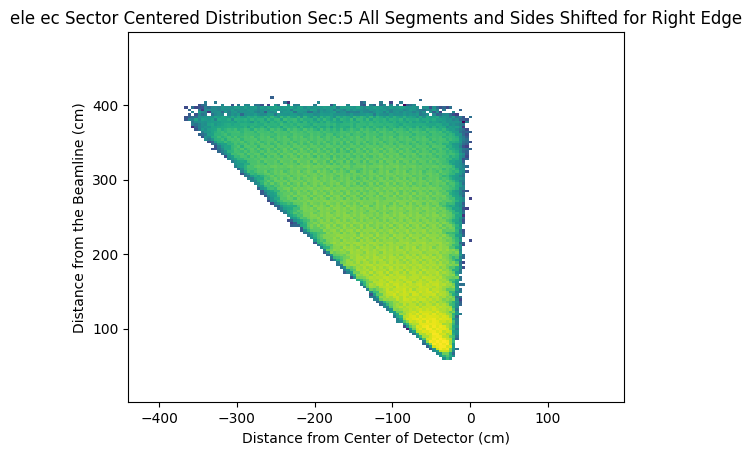

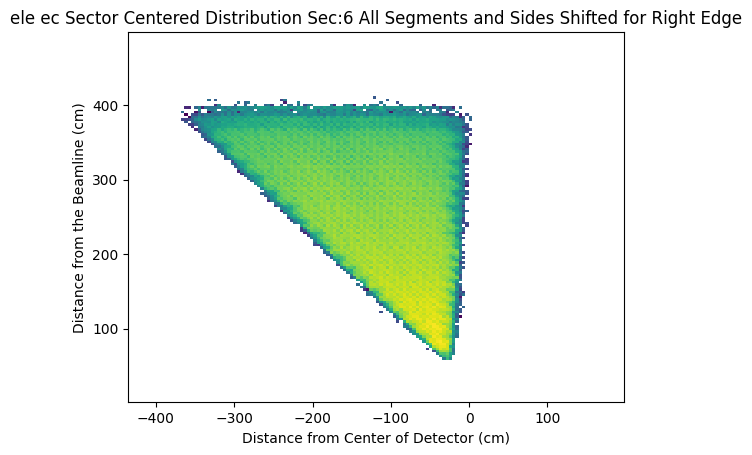

In [19]:
#Shifting for Right Edge
dumb1_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sr = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sr = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sr[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/right_rot[sec]
                dumb1_y_sr[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sr[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sr[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sr[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/right_rot[sec]
                dense2_sr[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x_sr[sec][cut_hist_len-1], dumb1_y_sr[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sr[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

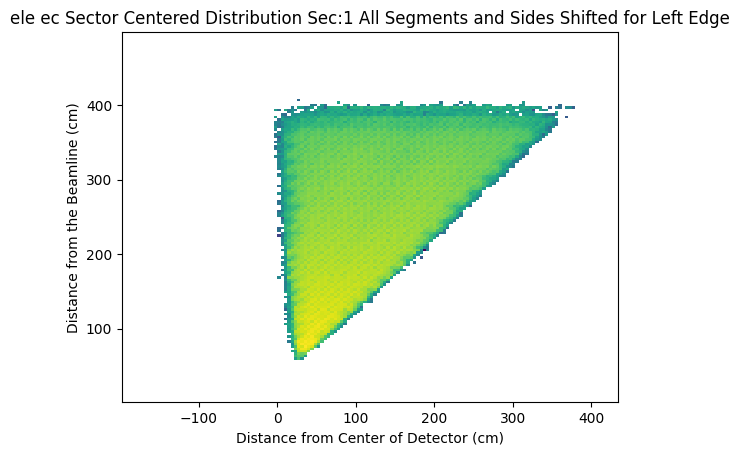

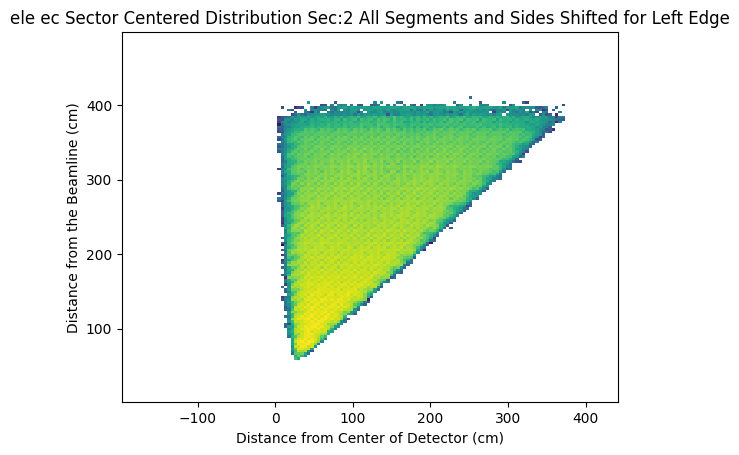

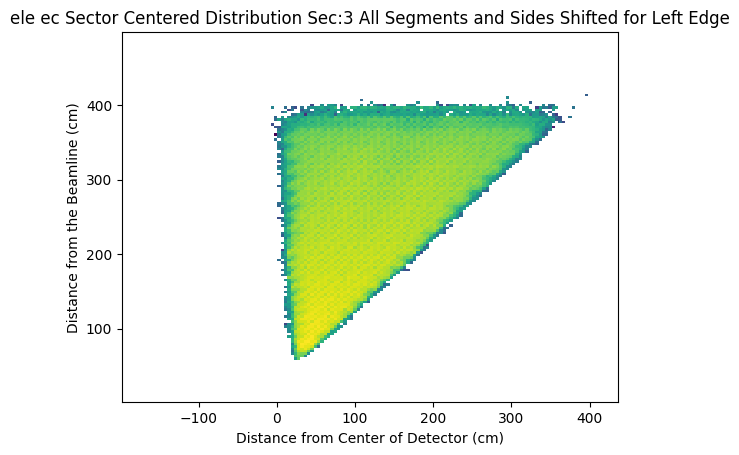

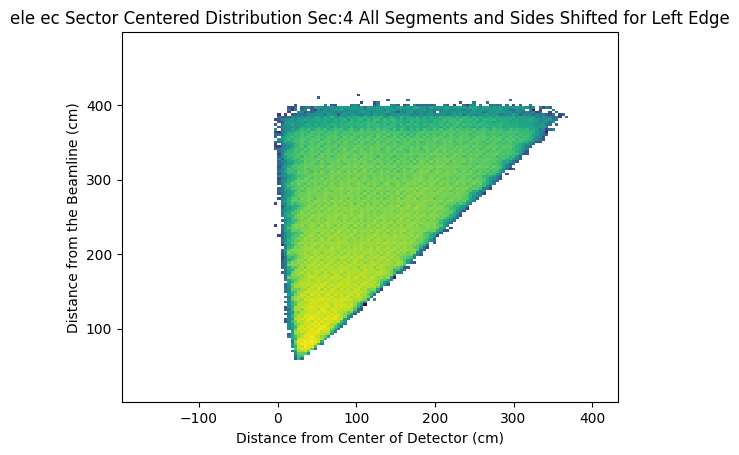

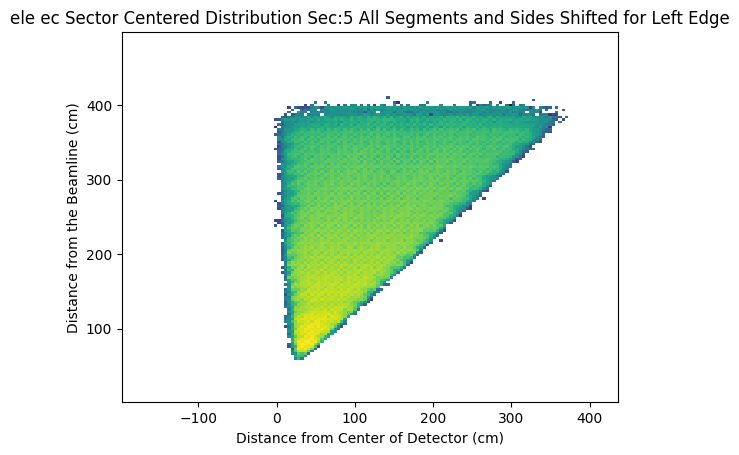

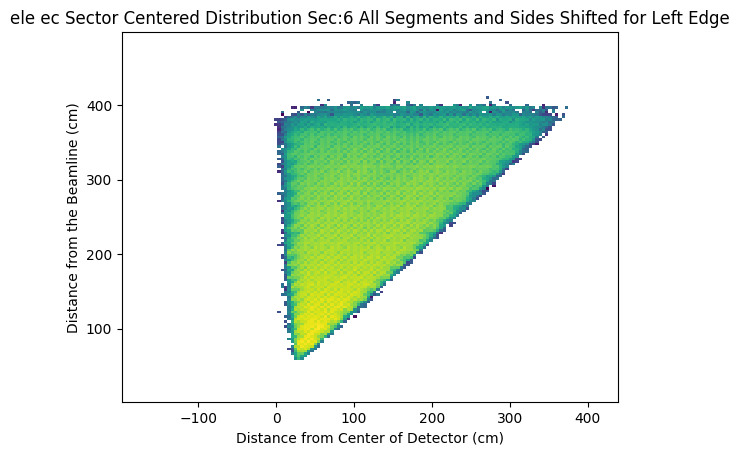

In [20]:
#Shifting for Left Edge
dumb1_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sl = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sl = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sl[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/left_rot[sec]
                dumb1_y_sl[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sl[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sl[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sl[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/left_rot[sec]
                dense2_sl[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x_sl[sec][cut_hist_len-1], dumb1_y_sl[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sl[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Left Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [21]:
proj_y = np.zeros((7,cut_hist_len,ydim))
proj_xr = np.zeros((7,cut_hist_len,xdim))
proj_xl = np.zeros((7,cut_hist_len,xdim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for hist_idx in range(cut_hist_len):
                proj_y[sec][hist_idx][i] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/right_rot[sec]) > 0:
                    proj_xr[sec][hist_idx][j-shift_idx(yvals[i]/right_rot[sec])] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/left_rot[sec]) < xdim-1:
                    proj_xl[sec][hist_idx][j-shift_idx(yvals[i]/left_rot[sec])] += zvals_xy[sec][hist_idx][j][i]

[-1.10030876e+01 -2.73322125e+01  4.42186849e+01  3.20966760e+05]


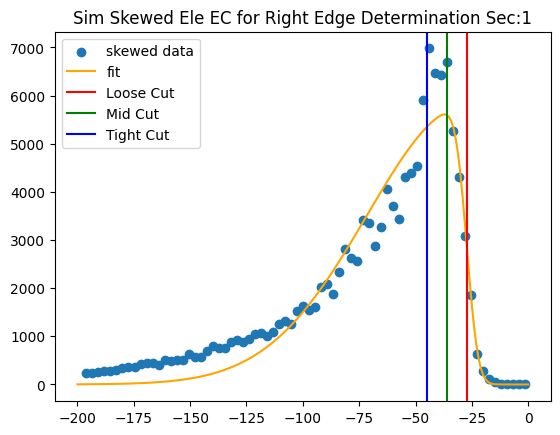

[-1.13558179e+01 -2.97957216e+01  6.17918322e+01  2.06529112e+05]


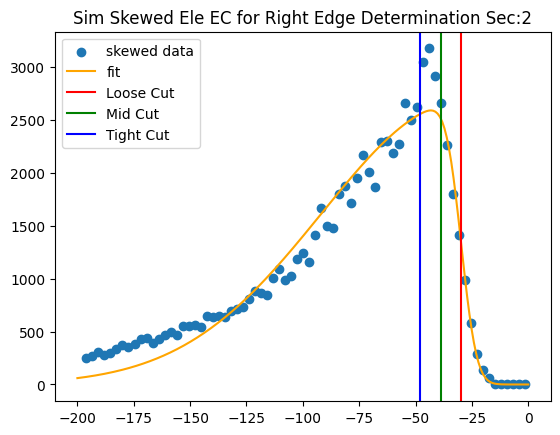

[-1.52344716e+01 -2.71252963e+01  7.22555671e+01  1.30385470e+05]


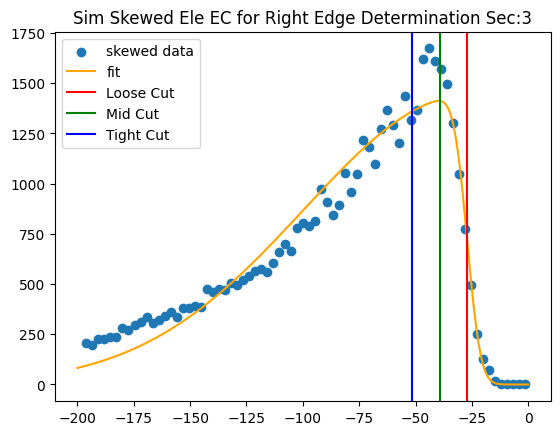

[-1.37812003e+01 -2.60851011e+01  5.18971158e+01  2.44415117e+05]


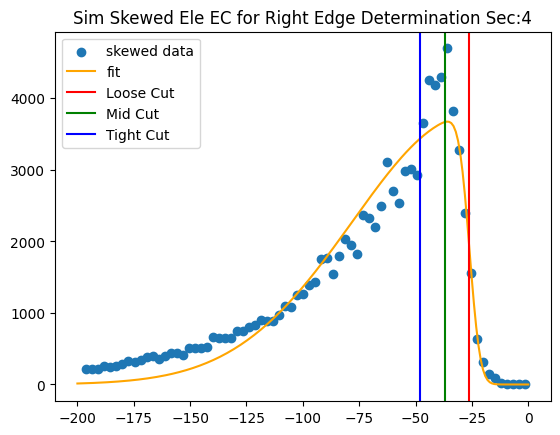

[-8.50256785e+00 -2.91446466e+01  3.74610285e+01  4.71038101e+05]


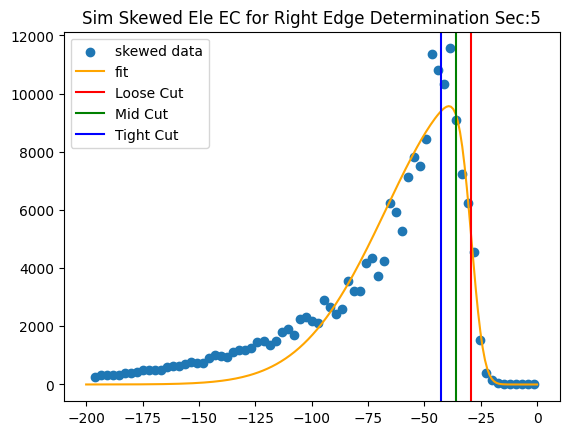

[-1.29472398e+01 -2.86194334e+01  5.92828988e+01  1.70852250e+05]


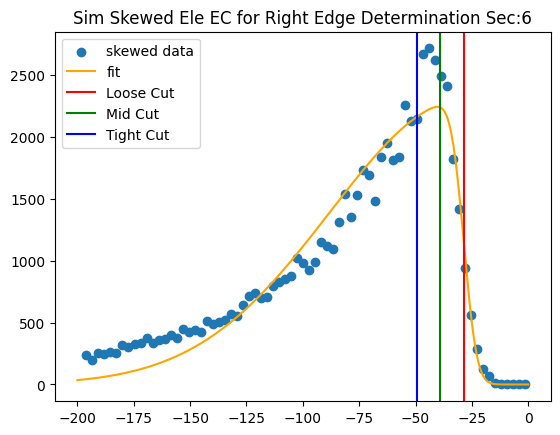

[-6.87605471e+04 -3.60001906e+01  6.09027663e+01  1.57310193e+06]


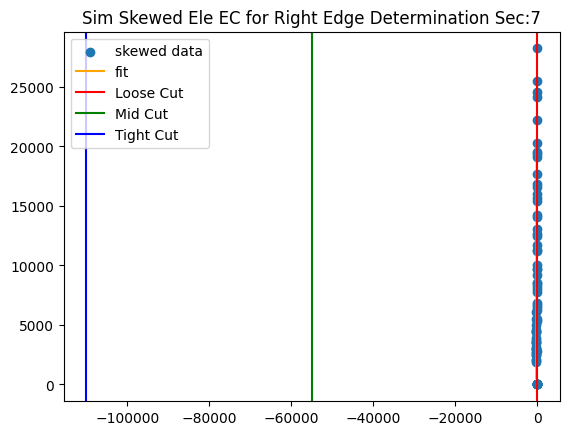

In [22]:
right_edge = [[-50.,-50,-50.] for i in range(7)]

ini_par = [-6.23,-41,54,51670]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,-198,0.0)
    mod_zvals = Bounds_on_X_From_Y(proj_xr[sec][0],xvals,-198,0.0)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(-200,0,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        right_edge[sec][2] = pars[1]
        right_edge[sec][1] = pars[1]+0.8*pars[0]
        right_edge[sec][0] = pars[1]+1.6*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=right_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=right_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=right_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Sim Skewed Ele EC for Right Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[1.04229329e+01 2.82172518e+01 4.46414041e+01 3.22654859e+05]


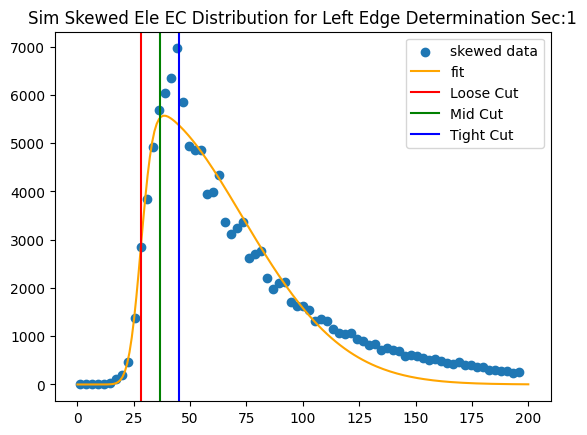

[1.24363737e+01 3.02991321e+01 6.37006859e+01 2.07945396e+05]


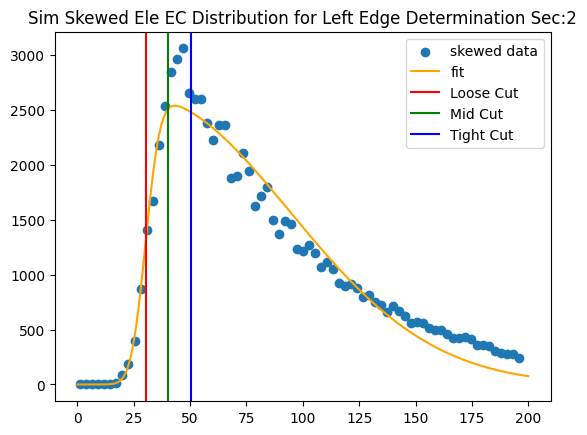

[1.42152767e+01 2.83609320e+01 7.07860032e+01 1.29368331e+05]


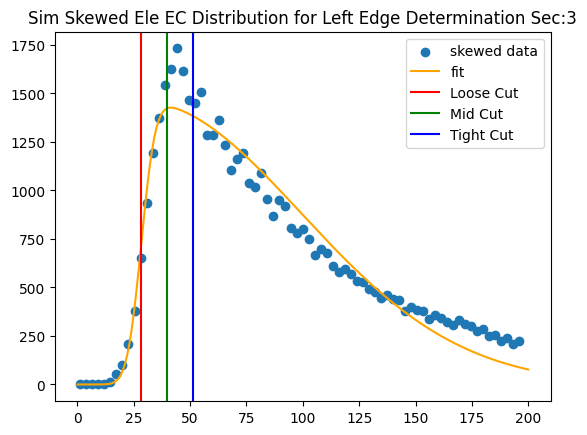

[1.12948979e+01 2.83416864e+01 5.01053922e+01 2.42124641e+05]


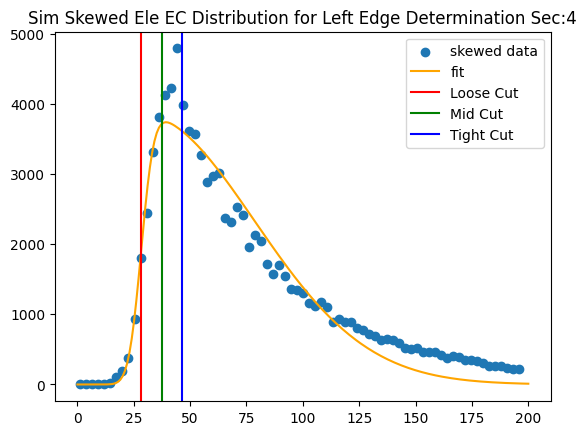

[9.75997871e+00 2.82405471e+01 3.67880808e+01 4.71519706e+05]


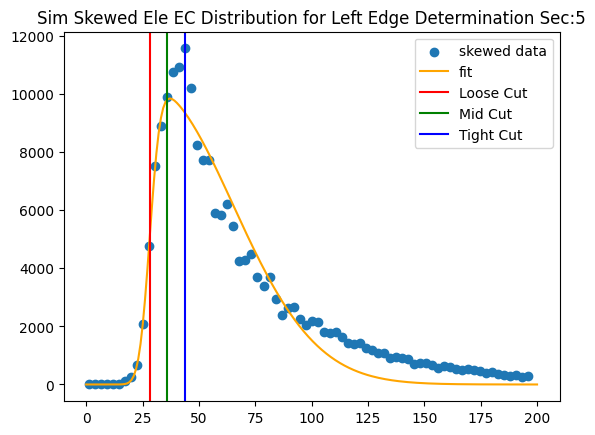

[1.25431371e+01 2.99114103e+01 6.10364648e+01 1.71677753e+05]


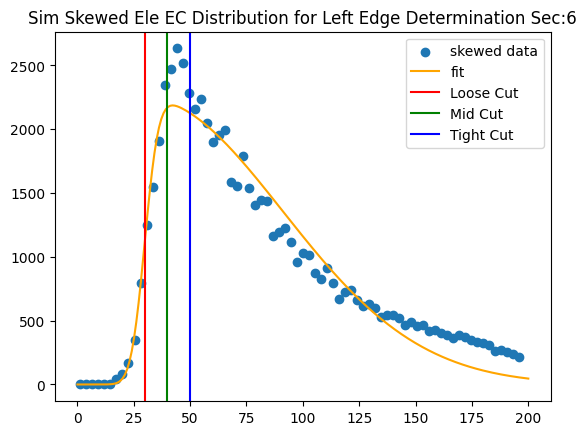

[2.66170795e+02 2.50482925e+02 2.07442503e+04 2.04961195e+08]


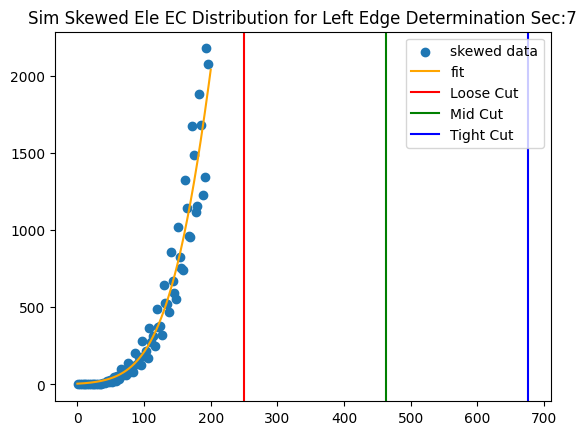

In [23]:
left_edge = [[50.,50,50.] for i in range(7)]

ini_par = [6.23,41,54,51670]

for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,0.0,198)
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][0],xvals,0.0,198)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(0.0,200,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        left_edge[sec][2] = pars[1]
        left_edge[sec][1] = pars[1]+0.8*pars[0]
        left_edge[sec][0] = pars[1]+1.6*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=left_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=left_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=left_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Sim Skewed Ele EC Distribution for Left Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

In [24]:
def exp_off(x_, a_, mu_,d_):
    return a_*np.exp(-(x_-mu_)/d_)

def exp_off_edge(comp_,frac_, a_, mu_, d_):
    return -d_*(math.log(frac_)-((comp_-mu_)/d_)-(mu_/d_))

[1.04919021e+04 3.18083963e+02 1.00165213e+01]


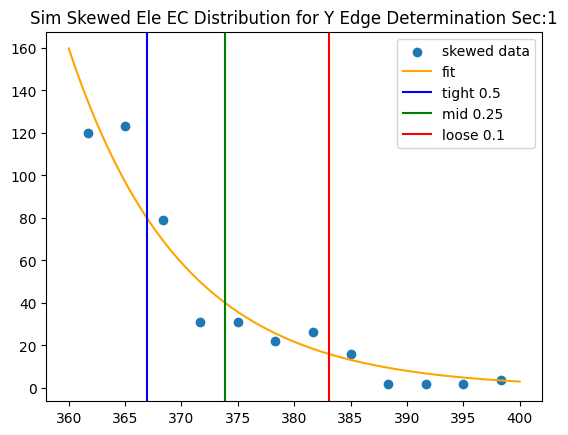

[1.08657226e+04 3.18070337e+02 9.92094248e+00]


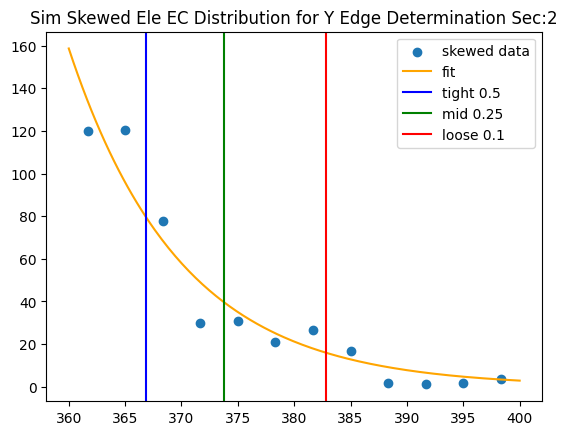

[1.04601768e+04 3.16721874e+02 1.03826328e+01]


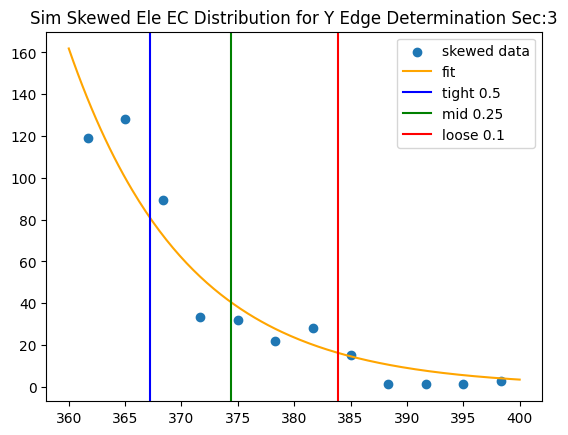

[1.57404708e+04 3.12487814e+02 1.01614547e+01]


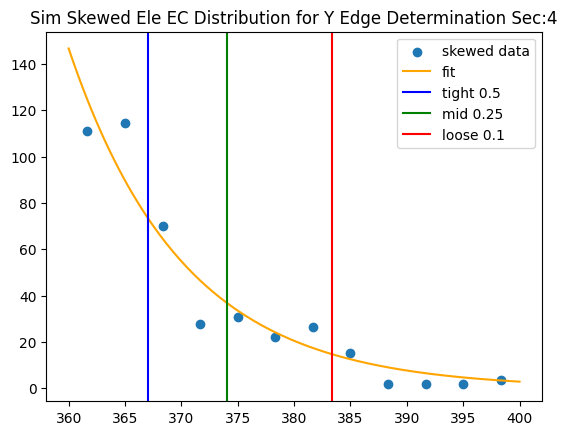

[8993.83428641  318.70986472   10.36860863]


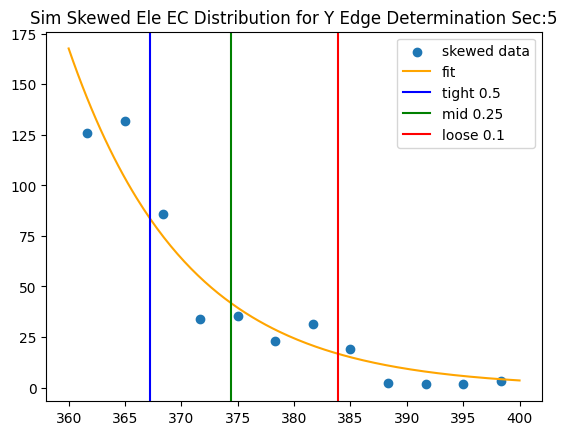

[1197.69427253  339.7658964     9.65486361]


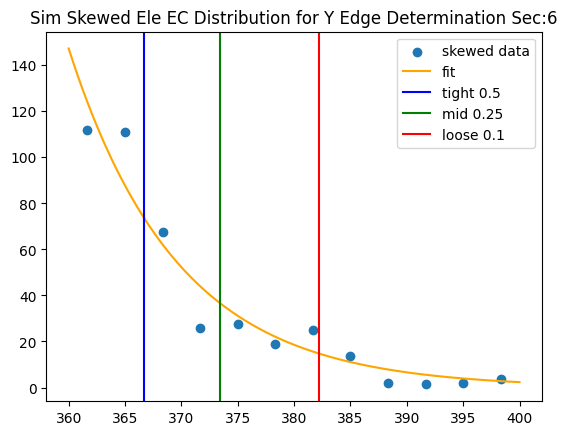

[9928.3884261   336.21691202   10.09662277]


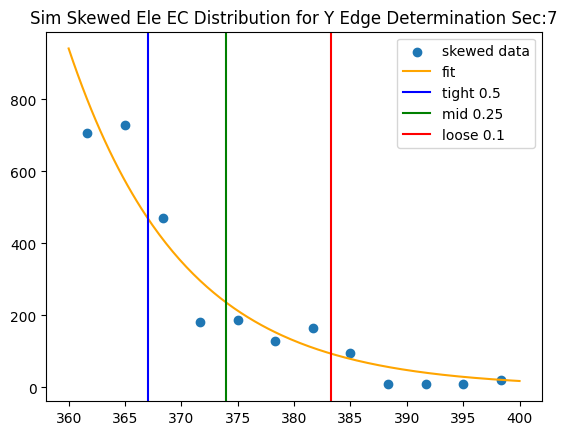

In [25]:
y_edge = np.zeros((7,3))

ini_par = [1359.29693959,  184.29431595,   43.19563841]

bou_y = [360.0,400.0]

comp_x = 360.0

frac_y = [0.5,0.25,0.1]

for sec in range(7):
    mod_xvals = Bounds_on_Y(yvals,bou_y[0],bou_y[1])
    mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou_y[0],bou_y[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou_y[0],bou_y[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(exp_off,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,exp_off(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for cut in range(3):
            y_edge[sec][cut] = exp_off_edge(comp_x,frac_y[cut],*pars)
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=y_edge[sec][cut],label="{} {}".format(cut_name[cut],frac_y[cut]),color=color_order[cut])
    plt.title("Sim Skewed Ele EC Distribution for Y Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

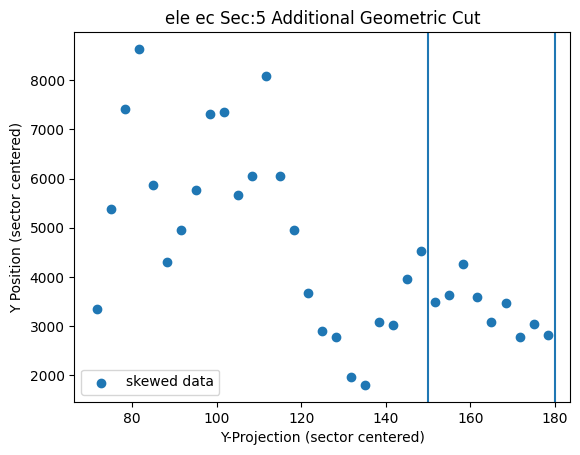

In [26]:
#Additional Cut on Sector 5 Needed
# First isolate area we are cuting to get approx linar background
sec = 4
bou = [70,180]
#determined by eye
bou2 = [150,180]
mod_xvals = Bounds_on_Y(yvals,bou[0],bou[1])
mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou[0],bou[1])
plt.scatter(mod_xvals,mod_zvals,label="skewed data")
plt.axvline(x=bou2[0])
plt.axvline(x=bou2[1])
plt.title(species+" "+detector+" Sec:{} Additional Geometric Cut".format(sec+1))
plt.xlabel("Y-Projection (sector centered)")
plt.ylabel("Y Position (sector centered)")
plt.legend()
plt.show()



[9565.7801238   -37.67109575]


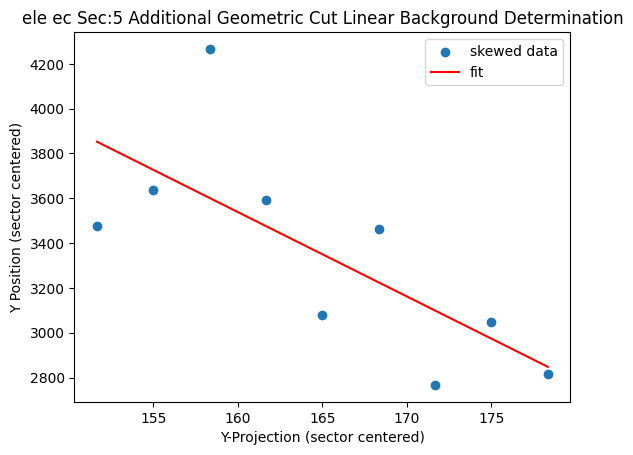

In [27]:

sec5_lin_bk = np.zeros(2)
test_pars = [10000,-100]

sec = 4
mod_xvals = Bounds_on_Y(yvals,bou2[0],bou2[1])
mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou2[0],bou2[1])
plt.scatter(mod_xvals,mod_zvals,label="skewed data")
cont_x = np.linspace(mod_xvals[0],mod_xvals[len(mod_xvals)-1],200)
#plt.plot(cont_x,Poly(cont_x,test_pars[side]),label="{} initial fit".format(slope_sides[side]))
try:
    pars, pars_cov = op.curve_fit(Linear,mod_xvals,mod_zvals,p0=test_pars,maxfev=5000)
    print(pars)
    plt.plot(cont_x,Poly(cont_x,pars),label="fit",color='r')
    for i in range(2):
        sec5_lin_bk[i] = pars[i]
except RuntimeError:
    print("Runtime Error")
except ValueError:
    print("Value Error")
    
    
plt.title(species+" "+detector+" Sec:{} Additional Geometric Cut Linear Background Determination".format(sec+1))
plt.xlabel("Y-Projection (sector centered)")
plt.ylabel("Y Position (sector centered)")
plt.legend()
plt.show()

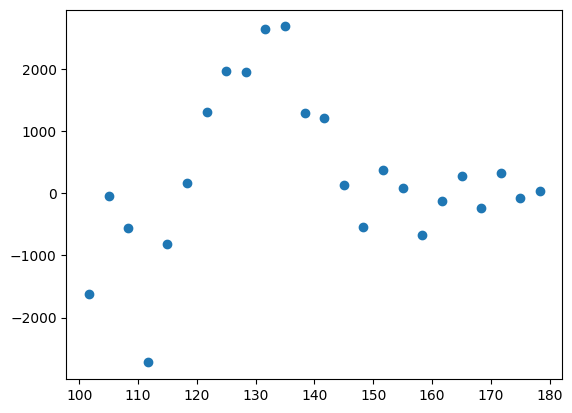

In [28]:
#Isolating The Range Down
sec = 4
bou = [100,180]
mod_xvals = Bounds_on_Y(yvals,bou[0],bou[1])
mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou[0],bou[1])
mod_zvals2 = [-mod_zvals[i]+Poly(mod_xvals[i],sec5_lin_bk) for i in range(len(mod_zvals))]
plt.scatter(mod_xvals,mod_zvals2,label="skewed data")

plt.show()

[2383.6485889   131.21568864    7.32279423    3.38173319]


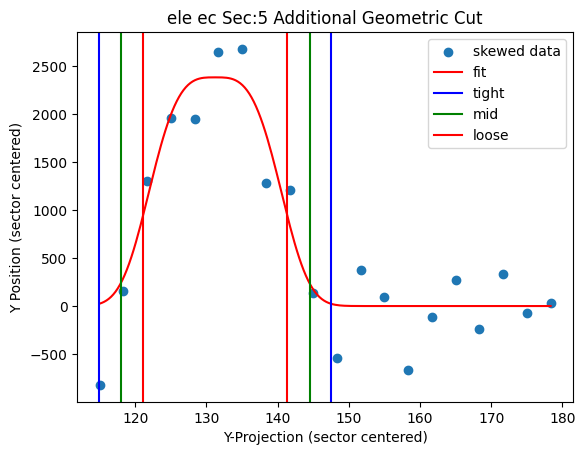

In [29]:
#Additional Cut on Sector 5 Needed

vert_cuts = np.zeros((3,2))

test_pars = [2000,130,10,5]

s5_gaus_fracs = [0.01,0.1,0.4]

#Isolating The Range Down
sec = 4
bou = [115,180]
mod_xvals = Bounds_on_Y(yvals,bou[0],bou[1])
mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou[0],bou[1])
mod_zvals2 = [-mod_zvals[i]+Poly(mod_xvals[i],sec5_lin_bk) for i in range(len(mod_zvals))]
plt.scatter(mod_xvals,mod_zvals2,label="skewed data")
cont_x = np.linspace(mod_xvals[0],mod_xvals[len(mod_xvals)-1],200)
#plt.plot(cont_x,Poly(cont_x,test_pars),label="initial fit")
try:
    pars, pars_cov = op.curve_fit(Super_Gaus,mod_xvals,mod_zvals2,p0=test_pars,maxfev=5000)
    print(pars)
    plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="fit",color='r')
    for i in range(3):
        vert_cuts[i][0] = super_gaus_cut_bound(s5_gaus_fracs[i],0,*pars)
        vert_cuts[i][1] = super_gaus_cut_bound(s5_gaus_fracs[i],1,*pars)
except RuntimeError:
    print("Runtime Error")
except ValueError:
    print("Value Error")
for cut in range(3):
    plt.axvline(x=vert_cuts[cut][0],color=color_order[cut],label=cut_name[cut])
    plt.axvline(x=vert_cuts[cut][1],color=color_order[cut])
plt.title(species+" "+detector+" Sec:{} Additional Geometric Cut".format(sec+1))
plt.xlabel("Y-Projection (sector centered)")
plt.ylabel("Y Position (sector centered)")
plt.legend()
plt.show()

sec_5_cuts = [[vert_cuts[cut][0],vert_cuts[cut][1]] for cut in range(3)]

[[[96.11720294530498, 2.138925082422291], [77.28937891061152, 2.138925082422291], [58.46155487591806, 2.138925082422291]], [[100.20126848500325, 2.0890483722247235], [81.22298609245047, 2.0890483722247235], [62.24470369989769, 2.0890483722247235]], [[108.99937857847867, 2.1164742619712453], [83.20468497947842, 2.1164742619712453], [57.40999138047813, 2.1164742619712453]], [[103.30496998954492, 2.146149863586883], [79.64375304418807, 2.146149863586883], [55.98253609883123, 2.146149863586883]], [[88.3542592584878, 2.06682648345734], [74.29559332775615, 2.06682648345734], [60.23692739702449, 2.06682648345734]], [[103.78016279976086, 2.103580156048224], [81.99171749078907, 2.103580156048224], [60.2032721818173, 2.103580156048224]], [[190617.17188681397, 1.7320508075688772], [95339.76302298738, 1.7320508075688772], [62.35415916077937, 1.7320508075688772]]]
[[96.11720294530498, 2.138925082422291], [77.28937891061152, 2.138925082422291], [58.46155487591806, 2.138925082422291]]


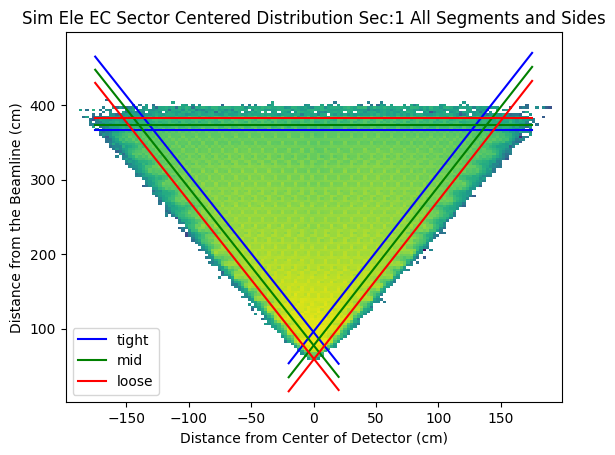

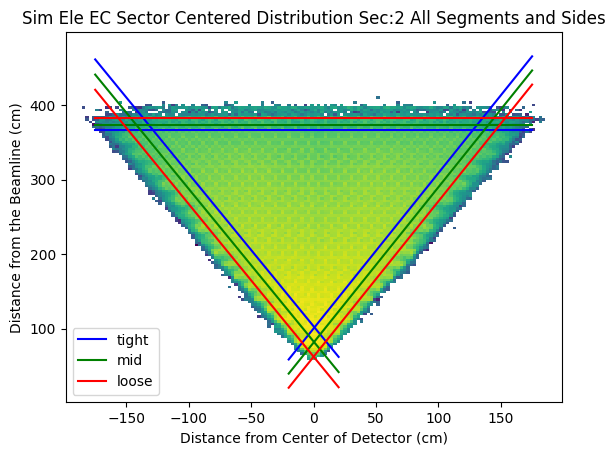

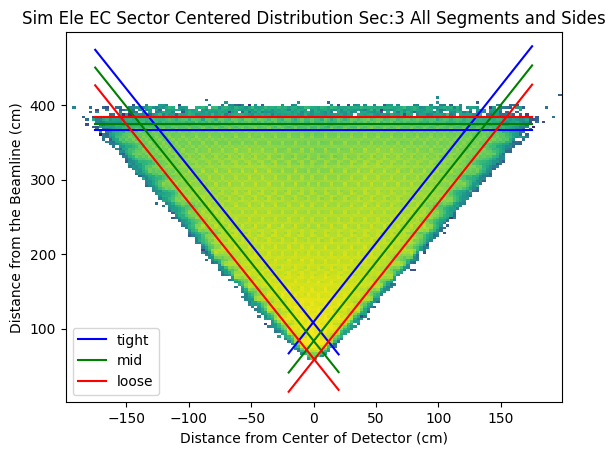

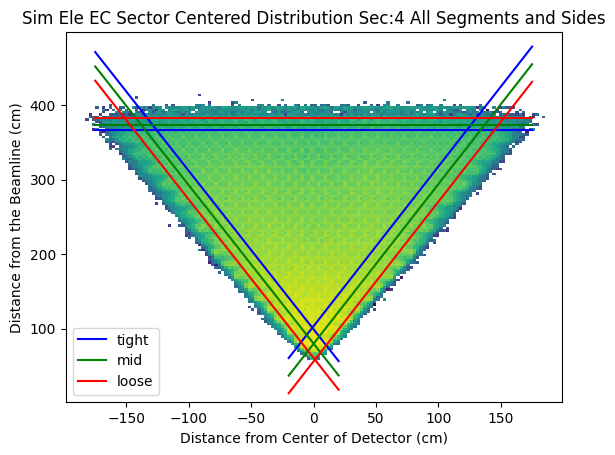

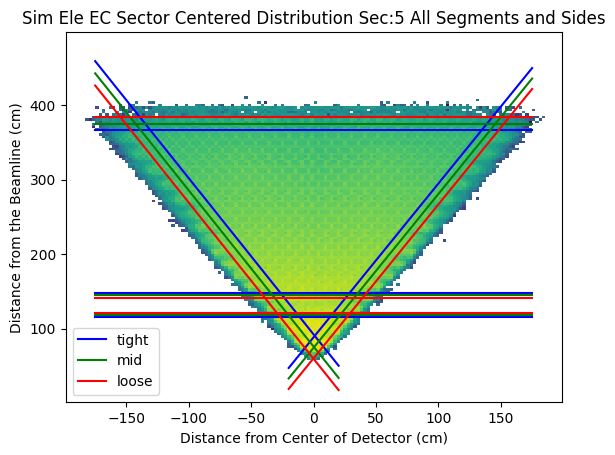

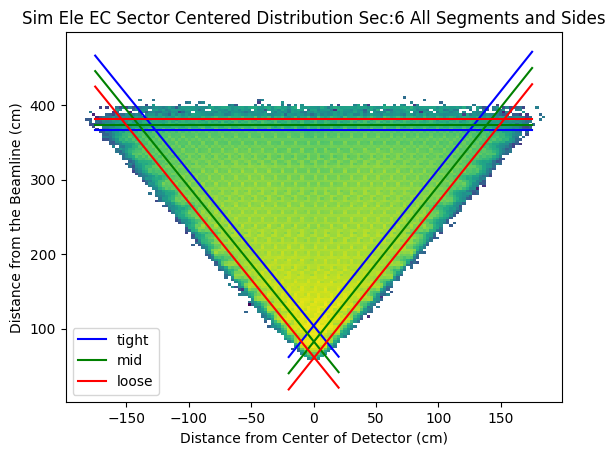

In [35]:
right_cut_pars = [[[-right_edge[sec][cut_idx]*right_rot[sec],right_rot[sec]] for cut_idx in range(3)] for sec in range(7)]
left_cut_pars = [[[left_edge[sec][cut_idx]*(-left_rot[sec]),left_rot[sec]] for cut_idx in range(3)] for sec in range(7)]

#side_cut_pars = [[[-right_edge[sec][cut_idx1]*3**(1/2),3**(1/2)] for cut_idx1 in range(3)],[[left_edge[sec][cut_idx2]*3**(1/2),-(3**(1/2))] for cut_idx2 in range(3)] for sec in range(7)]

#print(right_cut_pars)
#print(right_cut_pars[0])

cont_x_r = np.linspace(-20.0,175.,200)
cont_x_l = np.linspace(-175.0,20.,200)

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    for cut in range(3):
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
        plt.plot([-175,175],[y_edge[sec][cut],y_edge[sec][cut]],color=color_order[cut])
        if sec == 4:
            #sec_5_cuts = [[vert_cuts[cut][0],vert_cuts[cut][1]] for cut in range(3)]
            plt.plot([-175,175],[sec_5_cuts[cut][0],sec_5_cuts[cut][0]],color=color_order[cut])
            plt.plot([-175,175],[sec_5_cuts[cut][1],sec_5_cuts[cut][1]],color=color_order[cut])
            #plt.axhline(y=sec_5_cuts[cut][0],color=color_order[cut])
            #plt.axhline(y=sec_5_cuts[cut][1],color=color_order[cut])
    plt.title("Sim Ele EC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.legend()
    plt.show()


In [31]:
print("Cut Parameters for "+species+" "+detector+" Geometric Cut")
print("side_cut_par[sec][tight,mid,loose][right,left][intercept,slope]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                print("{\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
            else:
                print("\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        elif cut ==2:
            if sec == 5:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}}}")
            else:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}},")
        else:
            print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
    
        
        

Cut Parameters for ele ec Geometric Cut
side_cut_par[sec][tight,mid,loose][right,left][intercept,slope]
{	{	{	{ 96.11720294530498 , 2.138925082422291 },{ 95.02336573192179 , -2.11661877524984 }},
		{	{ 77.28937891061152 , 2.138925082422291 },{ 77.37426532053597 , -2.11661877524984 }},
		{	{ 58.46155487591806 , 2.138925082422291 },{ 59.72516490915013 , -2.11661877524984 }}},
	{	{	{ 100.20126848500325 , 2.0890483722247235 },{ 102.90567259145143 , -2.0500228343876707 }},
		{	{ 81.22298609245047 , 2.0890483722247235 },{ 82.50979261363992 , -2.0500228343876707 }},
		{	{ 62.24470369989769 , 2.0890483722247235 },{ 62.113912635828406 , -2.0500228343876707 }}},
	{	{	{ 108.99937857847867 , 2.1164742619712453 },{ 107.2670486737832 , -2.098938693245168 }},
		{	{ 83.20468497947842 , 2.1164742619712453 },{ 83.39745315065211 , -2.098938693245168 }},
		{	{ 57.40999138047813 , 2.1164742619712453 },{ 59.52785762752102 , -2.098938693245168 }}},
	{	{	{ 103.30496998954492 , 2.146149863586883 },{ 98.8451613

In [32]:
print("Top Cut for "+species+" "+detector+" Geometric Cut")
print("[sec][tight,mid,loose]")
for sec in range(6):
    for cut in range(3):
        if cut==0:
            if sec == 0:
                print("{\t{",y_edge[sec][cut],end=",")
            else:
                print("\t{",y_edge[sec][cut],end=",")
        elif cut==2:
            if sec == 5:
                print(y_edge[sec][cut],"}}")
            else:
                print(y_edge[sec][cut],"},")
        else:
            print(y_edge[sec][cut],end=",")
            

Top Cut for ele ec Geometric Cut
[sec][tight,mid,loose]
{	{ 366.9429234677921,373.8858469355843,383.06389252831156 },
	{ 366.876673308871,373.75334661774195,382.84381426410044 },
	{ 367.19669263716133,374.3933852743226,383.9068954616552 },
	{ 367.0433836725476,374.08676734509515,383.39761410490667 },
	{ 367.1869718348758,374.37394366975155,383.874603655438 },
	{ 366.69224148988775,373.38448297977556,382.23114502302906 }}


In [33]:
print("Sector 5 efficiency cut")
print("[tight,mid,loose][bot,top]")
for cut in range(3):
    if cut==0:
        print("{\t{",sec_5_cuts[cut][0],",",sec_5_cuts[cut][1],"},")
    elif cut==2:
        print("\t{",sec_5_cuts[cut][0],",",sec_5_cuts[cut][1],"}}")
    else:
        print("\t{",sec_5_cuts[cut][0],",",sec_5_cuts[cut][1],"},")
    
                                                                      

Sector 5 efficiency cut
[tight,mid,loose][bot,top]
{	{ 114.94830184573516 , 147.48307544069309 },
	{ 117.96308192490883 , 144.4682953615194 },
	{ 121.12397700725974 , 141.3074002791685 }}
